In [1]:
from pathlib import Path
import h5py

from hloc import (
    extract_features,
    match_features,
    reconstruction,
    visualization,
    pairs_from_exhaustive,
)
from hloc.visualization import plot_images, read_image
from hloc.utils import viz_3d

from hloc.utils.io import read_image
from hloc.utils.viz import add_text, cm_RdGn, plot_images, plot_keypoints, plot_matches

import cv2
import numpy as np
import py360convert

from collections import defaultdict

from matplotlib import pyplot as plt
%matplotlib inline

%cd /cvlabscratch/cvlab/home/engilber/dev/MARMOT/code
%pwd

/cvlabscratch/cvlab/home/engilber/dev/MARMOT/code


/usr/local/lib/python3.10/dist-packages/IPython/core/magics/osm.py:417: UserWarning: This is now an optional IPython functionality, setting dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


'/cvlabscratch/cvlab/home/engilber/dev/MARMOT/code'

In [2]:
images = Path("../data/0-calibration/images")
outputs = Path("../data/0-calibration/outputs/")

# Load matches
sfm_pairs = outputs / "pairs-sfm.txt"
features = outputs / "features.h5"
matches = outputs / "matches.h5"


with open(sfm_pairs, "r") as fd:
    images_pairs = [tuple(l.strip().split()) for l in fd.readlines()]

with h5py.File(features, "r") as fd:
    print(fd.keys())
    print(fd["cam1_view_forward"].keys())
    print(fd["cam1_view_forward"]["100.jpg"].keys())
    print(fd["cam1_view_forward"]["100.jpg"]["descriptors"][...].shape)
    print(fd["cam1_view_forward"]["100.jpg"]["keypoint_scores"][...])
    print(fd["cam1_view_forward"]["100.jpg"]["keypoints"][...])
    

    print(fd.keys())
    print(fd["cam360_view_forward"].keys())
    print(fd["cam360_view_forward"]["1200.jpg"].keys())
    print(fd["cam360_view_forward"]["1200.jpg"]["descriptors"][...].shape)
    print(fd["cam360_view_forward"]["1200.jpg"]["keypoint_scores"][...])

with h5py.File(matches, "r") as fd:
    # print(fd.keys())
    print(fd["cam1_view_forward-100.jpg"].keys())
    print(fd["cam1_view_forward-100.jpg"]["cam360_view_forward-1924.jpg"].keys())
    print(fd["cam1_view_forward-100.jpg"]["cam360_view_forward-1924.jpg"]["matches0"][...])
    print(fd["cam1_view_forward-100.jpg"]["cam360_view_forward-1924.jpg"]["matching_scores0"][...])


<KeysViewHDF5 ['cam1_view_forward', 'cam2_view_forward', 'cam360_view_back', 'cam360_view_down', 'cam360_view_forward', 'cam360_view_left', 'cam360_view_right', 'cam360_view_up', 'cam3_view_forward']>
<KeysViewHDF5 ['100.jpg', '200.jpg', '300.jpg', '400.jpg']>
<KeysViewHDF5 ['descriptors', 'image_size', 'keypoint_scores', 'keypoints']>
(128, 5000)
[43.66 56.66 43.5  ... 89.25 44.97 48.9 ]
[[578.   5.]
 [643.   5.]
 [672.   5.]
 ...
 [ 85. 695.]
 [ 76. 696.]
 [ 61. 698.]]
<KeysViewHDF5 ['cam1_view_forward', 'cam2_view_forward', 'cam360_view_back', 'cam360_view_down', 'cam360_view_forward', 'cam360_view_left', 'cam360_view_right', 'cam360_view_up', 'cam3_view_forward']>
<KeysViewHDF5 ['1200.jpg', '1251.jpg', '1303.jpg', '1355.jpg', '1406.jpg', '1458.jpg', '1510.jpg', '1562.jpg', '1613.jpg', '1665.jpg', '1717.jpg', '1768.jpg', '1820.jpg', '1872.jpg', '1924.jpg', '1975.jpg', '2027.jpg', '2079.jpg', '2131.jpg', '2182.jpg', '2234.jpg', '2286.jpg', '2337.jpg', '2389.jpg', '2441.jpg', '2493.jp

In [3]:
references = [p.relative_to(images).as_posix() for p in images.rglob('*.jpg')]

In [4]:
# Load test images and equirectangular

images = Path("../data/0-calibration/images")



img_id = 0 
cam, img_name = references[img_id].split("/")

print(references[img_id])

with h5py.File(features, "r") as fd:
    kpts = fd[cam][img_name]["keypoints"][...]
    # kpts_score = fd[cam][img_name]["keypoint_scores"][...]

cube_side = "back"
img_path2 = f"cam360_view_{cube_side}/2596.jpg"
cam2, img_name2 = img_path2.split("/")

with h5py.File(features, "r") as fd:
    kpts_2 = fd[cam2][img_name2]["keypoints"][...]
    # kpts_score_2 = fd[cam2][img_name2]["keypoint_scores"][...]

print(kpts.shape)
# print(kpts_score.shape)

cam1_view_forward/100.jpg
(5000, 2)


In [5]:
with h5py.File(matches, "r") as fd:
    matches_img1_img2 = (fd[f"{cam}-{img_name}"][f"{cam2}-{img_name2}"]["matches0"][...])
    matches_img1_img2_score = (fd[f"{cam}-{img_name}"][f"{cam2}-{img_name2}"]["matching_scores0"][...])
    
    idx = np.where(matches_img1_img2 != -1)[0]
    matches_img1_img2 = np.stack([idx, matches_img1_img2[idx]], -1)
    matches_img1_img2_score = matches_img1_img2_score[idx]

In [6]:
print(matches_img1_img2.shape)

(294, 2)


../data/0-calibration/images/cam1_view_forward/100.jpg
../data/0-calibration/images/cam360_view_back/2596.jpg


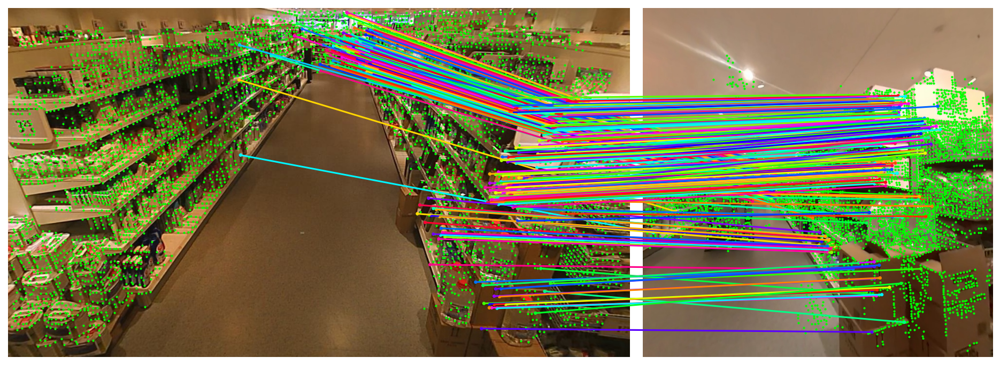

In [7]:
print(images / references[img_id])
print(images / img_path2)
image = read_image(images / references[img_id])
image2 = read_image(images / img_path2)

plot_images([image, image2], dpi=150)
plot_keypoints([kpts, kpts_2])
plot_matches(kpts[matches_img1_img2[:,0]], kpts_2[matches_img1_img2[:,1]])

In [8]:
image.shape

(720, 1280, 3)

In [9]:
# Visualize matches

def visualize_loc_from_log(
    image_dir,
    query_name,
    loc,
    reconstruction=None,
    db_image_dir=None,
    top_k_db=2,
    dpi=75,
):
    q_image = read_image(image_dir / query_name)
    if loc.get("covisibility_clustering", False):
        # select the first, largest cluster if the localization failed
        loc = loc["log_clusters"][loc["best_cluster"] or 0]

    inliers = np.array(loc["PnP_ret"]["inliers"])
    mkp_q = loc["keypoints_query"]
    n = len(loc["db"])
    if reconstruction is not None:
        # for each pair of query keypoint and its matched 3D point,
        # we need to find its corresponding keypoint in each database image
        # that observes it. We also count the number of inliers in each.
        kp_idxs, kp_to_3D_to_db = loc["keypoint_index_to_db"]
        counts = np.zeros(n)
        dbs_kp_q_db = [[] for _ in range(n)]
        inliers_dbs = [[] for _ in range(n)]
        for i, (inl, (p3D_id, db_idxs)) in enumerate(zip(inliers, kp_to_3D_to_db)):
            track = reconstruction.points3D[p3D_id].track
            track = {el.image_id: el.point2D_idx for el in track.elements}
            for db_idx in db_idxs:
                counts[db_idx] += inl
                kp_db = track[loc["db"][db_idx]]
                dbs_kp_q_db[db_idx].append((i, kp_db))
                inliers_dbs[db_idx].append(inl)
    else:
        # for inloc the database keypoints are already in the logs
        assert "keypoints_db" in loc
        assert "indices_db" in loc
        counts = np.array([np.sum(loc["indices_db"][inliers] == i) for i in range(n)])

    # display the database images with the most inlier matches
    db_sort = np.argsort(-counts)
    for db_idx in db_sort[:top_k_db]:
        if reconstruction is not None:
            db = reconstruction.images[loc["db"][db_idx]]
            db_name = db.name
            db_kp_q_db = np.array(dbs_kp_q_db[db_idx])
            kp_q = mkp_q[db_kp_q_db[:, 0]]
            kp_db = np.array([db.points2D[i].xy for i in db_kp_q_db[:, 1]])
            inliers_db = inliers_dbs[db_idx]
        else:
            db_name = loc["db"][db_idx]
            kp_q = mkp_q[loc["indices_db"] == db_idx]
            kp_db = loc["keypoints_db"][loc["indices_db"] == db_idx]
            inliers_db = inliers[loc["indices_db"] == db_idx]

        db_image = read_image((db_image_dir or image_dir) / db_name)
        color = cm_RdGn(inliers_db).tolist()
        text = f"inliers: {sum(inliers_db)}/{len(inliers_db)}"

        plot_images([q_image, db_image], dpi=dpi)
        plot_matches(kp_q, kp_db, color, a=0.1)
        add_text(0, text)
        opts = dict(pos=(0.01, 0.01), fs=5, lcolor=None, va="bottom")
        add_text(0, query_name, **opts)
        add_text(1, db_name, **opts)
        

In [10]:


import os
import sys
# Path to the code directory
BASEPATH = "/cvlabscratch/cvlab/home/engilber/dev/MARMOT/"
CODEPATH = os.path.join(BASEPATH, 'code')
DATAPATH = os.path.join(BASEPATH, 'data')
sys.path.append(CODEPATH)

from utils.log_utils import log
from utils.multiview_utils import Camera
from utils.metadata_utils import get_cam_names
from configs.arguments import get_config_dict
from utils.io_utils import write_json


In [11]:
sys.argv = []

In [12]:
from pathlib import Path

env_footage = Path(BASEPATH) / 'data' / 'raw_data' / 'footage'

cams = get_cam_names(env_footage)
camera_models_overrides_dict = {}
log.info(f"Found {(cams)} in environment footage.")

cameras = []
for cam in cams:
    cameras.append(Camera(cam, newest=False))

09:35:10.684 - [                    code/2051031622.py:007] - INFO     - Found ['cam1', 'cam2', 'cam3', 'cam360'] in environment footage.
09:35:10.690 - [             code/configs/arguments.py:093] - DEBUG    - No training config file specified, using default config in data_root/2-training/train_config.yaml
09:35:10.696 - [             code/configs/arguments.py:093] - DEBUG    - No training config file specified, using default config in data_root/2-training/train_config.yaml
09:35:10.699 - [         code/utils/multiview_utils.py:124] - DEBUG    - Indexing footage video Brinno104a-2023-09-20-mer..avi...
09:35:10.721 - [         code/utils/multiview_utils.py:136] - DEBUG    - Indexed 32393 frames for camera cam1
09:35:10.730 - [             code/configs/arguments.py:093] - DEBUG    - No training config file specified, using default config in data_root/2-training/train_config.yaml
09:35:10.751 - [             code/configs/arguments.py:093] - DEBUG    - No training config file specified, u

In [13]:
print(cameras)

[<utils.multiview_utils.Camera object at 0x7f8e2a7d9f90>, <utils.multiview_utils.Camera object at 0x7f902c0edc90>, <utils.multiview_utils.Camera object at 0x7f8e2a7db1c0>, <utils.multiview_utils.Camera object at 0x7f8e2a7db850>]


In [14]:
cam360 = cameras[-1]

img_eq = cam360.extract([2596])[0]
img_eq = cv2.cvtColor(img_eq, cv2.COLOR_BGR2RGB)

In [15]:
print(img_eq.shape)

(1920, 3840, 3)


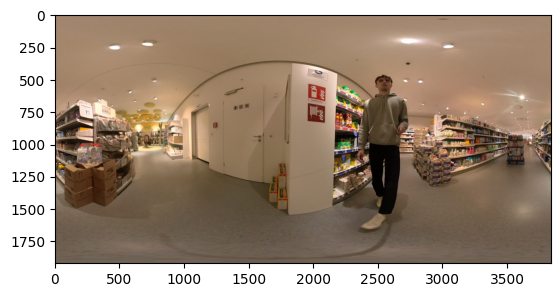

In [16]:
plt.imshow(img_eq)
plt.show()

In [17]:
perspectives = py360convert.e2c(img_eq, face_w=image2.shape[0], cube_format='horizon')

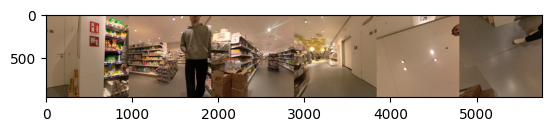

In [18]:
plt.imshow(perspectives)
plt.show()

In [19]:
perspectives_list = py360convert.e2c(img_eq, face_w=1280, cube_format='list')


In [20]:
perspectives_list[0].shape

(1280, 1280, 3)

In [21]:
import py360convert

assert image2.shape[0] == image2.shape[1]
face_w = image2.shape[0]

h,w = h, w = img_eq.shape[:2]

xyz = py360convert.utils.xyzcube(face_w)
uv = py360convert.utils.xyz2uv(xyz)
coor_xy = py360convert.utils.uv2coor(uv, h, w)


In [22]:
print(xyz.shape)
print(uv.shape)
print(coor_xy.shape)

(960, 5760, 3)
(960, 5760, 2)
(960, 5760, 2)


In [23]:
coor_xy.max(axis=(0,1))

array([3838.8628, 1918.5988], dtype=float32)

In [24]:
print(kpts_2.shape)

(5000, 2)


In [25]:
import numpy as np
from tqdm import tqdm
from scipy.spatial import KDTree

# face_to_id = {'forward':(1,1),
#                 'right':(2,1),
#                 'back':(3,1),
#                 'left':(0,1),
#                 'up':(1,0),
#                 'down':(1,2),
#               }

face_to_id = {'forward':0,
                'right':1,
                'back':2,
                'left':3,
                'up':4,
                'down':5,
              }

def coordinate_flip(coords, image_shape, flip_type):
    """
    Update coordinates after flipping an image.

    Parameters:
    coords (numpy array): Array of (x, y) coordinates of shape (n, 2).
    image_shape (tuple): Shape of the image as (height, width).
    flip_type (str): Type of flip, either 'fliplr' or 'flipud'.

    Returns:
    numpy array: Updated coordinates of shape (n, 2).
    """
    
    coords = np.array(coords)
    height, width = image_shape

    if flip_type == 'fliplr':
        coords[:, 0] = width - 1 - coords[:, 0]
    elif flip_type == 'flipud':
        coords[:, 1] = height - 1 - coords[:, 1]

    return coords

def coordinates_to_horizon(face_idx, coords, face_shape):
    """
    Convert multiple coordinates from a specific face to the corresponding coordinates in the horizon map.
    
    Parameters:
    face_idx (int): Index of the face (0 to 5).
    coords (numpy array): Array of shape (n, 2) where each row is a (x, y) coordinate in the face.
    face_shape (tuple): Shape of a single face (height, width).
    
    Returns:
    numpy array: Array of shape (n, 2) containing the corresponding coordinates in the horizon map.
    """
    h, w = face_shape[:2]
    
    # assert coords.shape[1] == 2, "Coordinates should be of shape (n, 2)"
    # assert np.all((0 <= coords[:, 0]) & (coords[:, 0] < w)), "x coordinates out of bounds"
    # assert np.all((0 <= coords[:, 1]) & (coords[:, 1] < h)), "y coordinates out of bounds"
    
    horizon_coords = np.copy(coords)
    horizon_coords[:, 0] += face_idx * w
    # horizon_coords[:, 1] += face_idx[1] * w
    
    
    return horizon_coords

# def find_closest_uv_coordinates(xy_array, image_coords):
#     """
#     Find the closest (u, v) coordinates in the uv array that map to the given (x, y) coordinates.

#     Parameters:
#     xy_array (numpy array): Array of shape (u, v, 2) where each location contains (x, y) coordinates.
#     image_coords (numpy array): Array of shape (n, 2) where each row is an (x, y) coordinate in the image.

#     Returns:
#     numpy array: Array of shape (n, 2) containing the corresponding coordinates (u, v) in the uv array.
#     """
#     u, v = xy_array.shape[:2]
#     n = image_coords.shape[0]

#     # Reshape xy_array and image_coords to enable broadcasting
#     xy_array_reshaped = xy_array.reshape(u * v, 2)
#     image_coords_reshaped = image_coords[:, np.newaxis, :]

#     # Calculate the Euclidean distances
#     distances = np.sqrt(np.sum((xy_array_reshaped - image_coords_reshaped) ** 2, axis=2))

#     # Find the indices of the minimum distances
#     closest_indices = np.argmin(distances, axis=1)

#     # Convert the flat indices to 2D indices
#     uv_coords = np.unravel_index(closest_indices, (u, v))

#     return np.vstack(uv_coords).T

def create_kdtree(xy_array):
    """
    Create a KDTree for the given (x, y) coordinates.

    Parameters:
    xy_array (numpy array): Array of shape (u, v, 2) where each location contains (x, y) coordinates.

    Returns:
    KDTree: KDTree built from the (x, y) coordinates.
    """
    u, v = xy_array.shape[:2]
    xy_flat = xy_array.reshape(-1, 2)  # Flatten the (u, v, 2) array to (u*v, 2)
    kdtree = KDTree(xy_flat)
    return kdtree

def find_closest_uv_coordinates(kdtree, xy_array, image_coords):
    """
    Find the closest (u, v) coordinates in the uv array that map to the given (x, y) coordinates.

    Parameters:
    kdtree (KDTree): KDTree built from the (x, y) coordinates.
    xy_array (numpy array): Array of shape (u, v, 2) where each location contains (x, y) coordinates.
    image_coords (numpy array): Array of shape (n, 2) where each row is an (x, y) coordinate in the image.

    Returns:
    numpy array: Array of shape (n, 2) containing the corresponding coordinates (u, v) in the uv array.
    """
    # Query the KDTree for the nearest neighbors
    distances, indices = kdtree.query(image_coords)
    
    # Convert the flat indices back to 2D (u, v) indices
    uv_shape = xy_array.shape[:2]
    uv_coords = np.unravel_index(indices, uv_shape)
    
    return np.vstack(uv_coords).T
    
# def find_closest_uv_coordinates(xy_array, image_coords):
#     """
#     Find the closest (u, v) coordinates in the uv array that map to the given (x, y) coordinates.

#     Parameters:
#     xy_array (numpy array): Array of shape (u, v, 2) where each location contains (x, y) coordinates.
#     image_coords (numpy array): Array of shape (n, 2) where each row is an (x, y) coordinate in the image.

#     Returns:
#     numpy array: Array of shape (n, 2) containing the corresponding coordinates (u, v) in the uv array.
#     """
#     uv_coords = []
#     for coord in tqdm(image_coords):
#         x, y = coord
#         xy_diff = xy_array - np.array([x, y])  # Compute difference with the target coordinate
#         distances = np.sqrt(np.sum(xy_diff ** 2, axis=-1))  # Calculate Euclidean distances
#         uv_coord = np.unravel_index(np.argmin(distances), distances.shape)  # Find the index of the minimum distance
#         uv_coords.append(uv_coord)
    
#     return np.array(uv_coords)

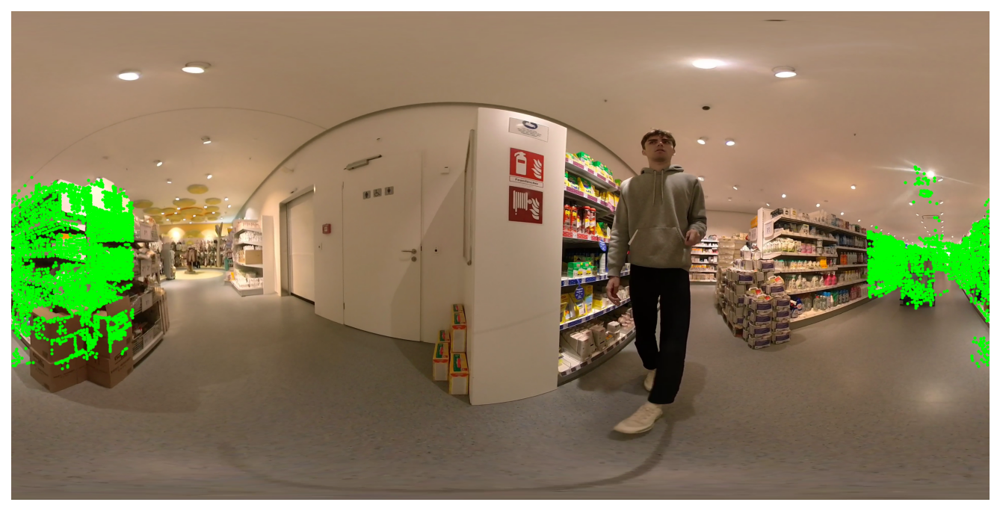

In [26]:
def kpts_to_eq(kpts, cube_face_shape, face_view, eq_image):

    # print(cube_face.shape)
    # print(kpts[:,].shape)
    
    # cube_color = cube_face[kpts[:,1].astype(int), kpts[:,0].astype(int)]
    
    #flip horizontally if face_view is right or back and vertically if face_view is top
    if face_view in ['right', 'back']:
        kpts = coordinate_flip(kpts, cube_face_shape, "fliplr")
    if face_view in ['up']:
        kpts = coordinate_flip(kpts, cube_face_shape, "flipud")
            
    #project kpts to cubemap stitched
    kpts_cubemap = coordinates_to_horizon(face_to_id[face_view], kpts, cube_face_shape)

    # perspectives = py360convert.e2c(eq_image, face_w=cube_face_shape[0], cube_format='horizon')
    
    # plot_images([perspectives], dpi=150)
    # plot_keypoints([kpts_cubemap])
    # plt.plot()
    #map kpts stitched to eq
    
    xyz = py360convert.utils.xyzcube(face_w)
    uv = py360convert.utils.xyz2uv(xyz)
    coor_xy = py360convert.utils.uv2coor(uv, h, w)

    # kdtree = create_kdtree(coor_xy)
    
    # kpts_eq = find_closest_uv_coordinates(kdtree, coor_xy, kpts_cubemap)

    # print(kpts_cubemap.shape)
    # print(kpts_cubemap[:,::-1].min(axis=0))
    # print(kpts_cubemap[:,::-1].max(axis=0))

    # print(coor_xy.shape)

    indices = kpts_cubemap.round().astype(int)
    # print("Min indices:", indices.min(axis=0))
    # print("Max indices:", indices.max(axis=0))

    # if (indices[:, 0] < 0).any() or (indices[:, 0] >= coor_xy.shape[0]).any() or (indices[:, 1] < 0).any() or (indices[:, 1] >= coor_xy.shape[1]).any():
    #     print("Indices are out of bounds!")
    
    kpts_eq = coor_xy[indices[:, 1], indices[:, 0]]

    eq_indices = kpts_eq.astype(int)
    eq_color = eq_image[eq_indices[:, 1], eq_indices[:, 0]]
    
    return kpts_eq, eq_color

kpts_eq, eq_color = kpts_to_eq(kpts_2, image2.shape[:2], cube_side, img_eq)

plot_images([img_eq], dpi=150)
plot_keypoints([kpts_eq])

# print(cube_color.astype(float) - eq_color.astype(float))

In [27]:
kpts[0]

array([578.,   5.], dtype=float16)

In [28]:
k_id = 0

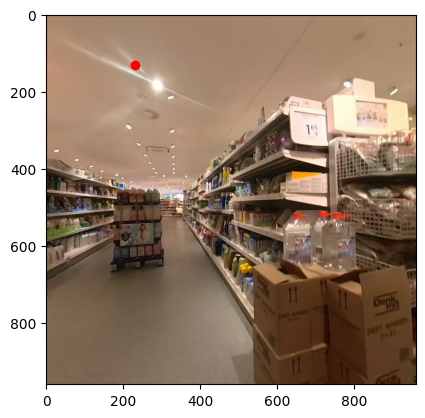

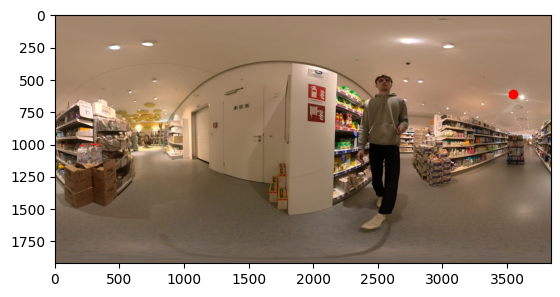

[195 177 155]
[199 180 159]


In [29]:
plt.imshow(image2)
plt.scatter(kpts_2[k_id][0], kpts_2[k_id][1], c="red")
plt.show()

plt.imshow(img_eq)
plt.scatter(kpts_eq[k_id][0], kpts_eq[k_id][1], c="red")
plt.show()

print(image2[int(kpts_2[k_id][1]), int(kpts_2[k_id][0])])
print(img_eq[int(kpts_eq[k_id][1]), int(kpts_eq[k_id][0])])


In [30]:
perspectives.shape

(960, 5760, 3)

In [31]:
eq_color[0]

array([199, 180, 159], dtype=uint8)

In [32]:
kpts_eq.shape

(5000, 2)

In [33]:
# Project back to equirectangular
# views_list = ['forward', 'right', 'back', 'left', 'up', 'down']

# perspectives = py360convert.e2c(frame, face_w=face_w, cube_format='list')
    
    
# for j, image in enumerate(perspectives):
#     # if views_list[j] in ['back', 'up', 'down']:
#     #     continue
#     cam_id = j + 1
#     views_folder = images_dir / f'{camera.name}_view_{views_list[j]}'
#     views_folder.mkdir(parents=True, exist_ok=True)
#     file_path =  views_folder / f'{index}.jpg' 
#     # cv2.imwrite(str(file_path), image)
    # metadata = pyexif.ExifEditor(file_path)
    # metadata.setTag('Model', camera.name)
    # metadata.setTag('Make', camera.name)
        

In [34]:
import numpy as np
# Load test ofpensfm formart
features = np.load("./notebooks/opensfm/features/cam1_281.jpg.features.npz")

print(features)
print(features["points"].shape)
print(features["descriptors"].shape)
print(features["colors"].shape)
print(features["segmentations"].shape)
print(features["instances"].shape)

for k in features.keys():
    print(k)

NpzFile './notebooks/opensfm/features/cam1_281.jpg.features.npz' with keys: points, descriptors, colors, segmentations, instances...
(4358, 4)
(4358, 128)
(4358, 3)
(0,)
(0,)
points
descriptors
colors
segmentations
instances
segmentation_labels
OPENSFM_FEATURES_VERSION


In [35]:
features["OPENSFM_FEATURES_VERSION"]

array(3)

In [36]:
def normalized_image_coordinates(
    pixel_coords: np.ndarray, width: int, height: int
) -> np.ndarray:
    size = max(width, height)
    p = np.empty((len(pixel_coords), 2))
    p[:, 0] = (pixel_coords[:, 0] + 0.5 - width / 2.0) / size
    p[:, 1] = (pixel_coords[:, 1] + 0.5 - height / 2.0) / size
    return p

def unnormalized_image_coordinates(
    normalized_coords: np.ndarray, width: int, height: int
) -> np.ndarray:
    size = max(width, height)
    pixel_coords = np.empty_like(normalized_coords)
    pixel_coords[:, 0] = normalized_coords[:, 0] * size - 0.5 + width / 2.0
    pixel_coords[:, 1] = normalized_coords[:, 1] * size - 0.5 + height / 2.0
    return pixel_coords

# points[:, 2:3] /= max(width, height)

In [37]:
img_o = cv2.imread("./notebooks/opensfm/images/cam1_281.jpg")
img_o = cv2.cvtColor(img_o, cv2.COLOR_BGR2RGB)

In [38]:
kpts_o = features["points"][:, :2]
kpts_o = unnormalized_image_coordinates(kpts_o, img_o.shape[1], img_o.shape[0])

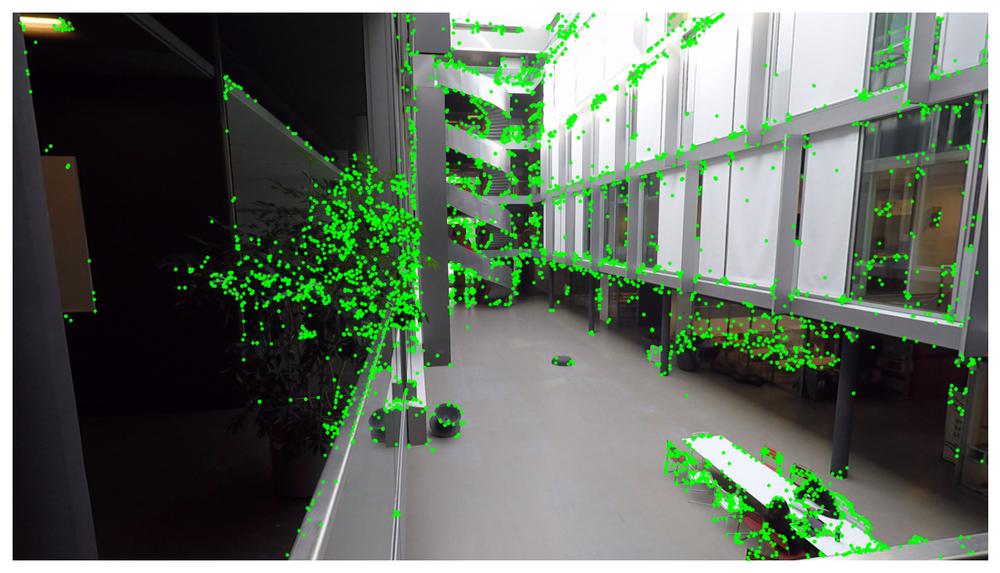

In [39]:
plot_images([img_o], dpi=150)
plot_keypoints([kpts_o])

In [40]:
features["points"][0]

array([-1.1092240e-01, -3.8012504e-03,  9.3566574e-04,  3.1438696e+02],
      dtype=float32)

In [41]:
import gzip
import pickle


with gzip.open("./notebooks/opensfm/matches/cam1_281.jpg_matches.pkl.gz", 'rb') as f:
    matches = pickle.load(f)

print(type(matches))
print(type(matches["cam360_2148.jpg"]))

print(matches.keys())
# for k,v in matches.items():
#     print(k, len(v))

print(matches["cam360_2148.jpg"].shape)
print(matches["cam360_2148.jpg"])

<class 'dict'>
<class 'numpy.ndarray'>
dict_keys(['cam360_1325.jpg', 'cam360_1419.jpg', 'cam360_455.jpg', 'cam360_1490.jpg', 'cam360_1537.jpg', 'cam360_1678.jpg', 'cam360_925.jpg', 'cam360_1631.jpg', 'cam360_2054.jpg', 'cam360_1208.jpg', 'cam360_2148.jpg', 'cam360_1654.jpg', 'cam360_1019.jpg', 'cam360_361.jpg', 'cam1_1408.jpg', 'cam360_761.jpg', 'cam360_2571.jpg', 'cam3_2006.jpg', 'cam360_408.jpg', 'cam360_643.jpg', 'cam360_1114.jpg', 'cam360_667.jpg', 'cam360_1843.jpg', 'cam360_2219.jpg', 'cam360_2289.jpg'])
(21, 2)
[[ 2196  4436]
 [ 2228  3638]
 [ 4308 20271]
 [ 4045 18329]
 [ 1860 11430]
 [ 1096   835]
 [  740  5050]
 [ 3350 15771]
 [  316 10577]
 [  533  6459]
 [ 1191  5989]
 [ 2150 11692]
 [ 3898 19123]
 [ 3463 16263]
 [ 3503  7641]
 [ 1988 10473]
 [ 4023 18964]
 [ 1401 10627]
 [ 2441  9018]
 [ 2495  9571]
 [ 1535  7601]]


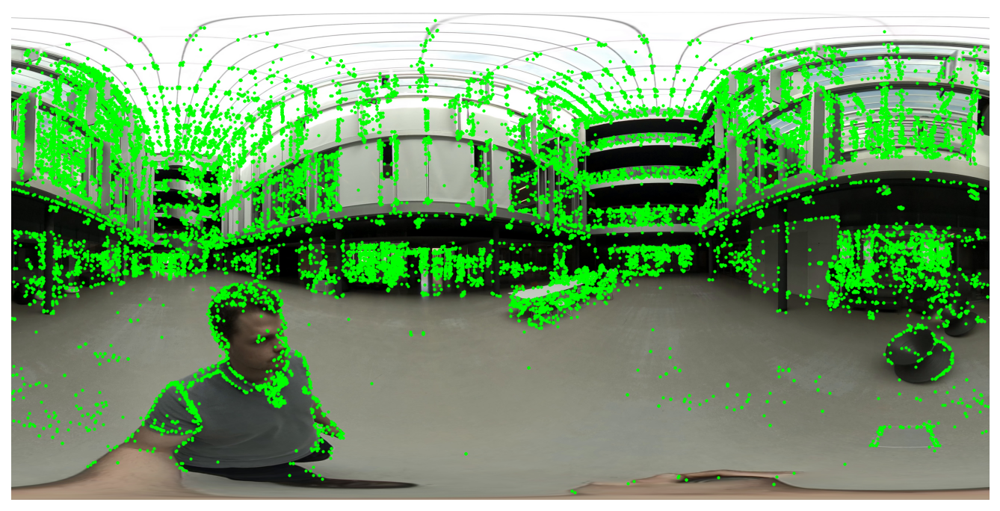

In [42]:
img_o_2 = cv2.imread("./notebooks/opensfm/images/cam360_2148.jpg")
img_o_2 = cv2.cvtColor(img_o_2, cv2.COLOR_BGR2RGB)

# plot_images([img_o_2], dpi=150)

features_2 = np.load("./notebooks/opensfm/features/cam360_2148.jpg.features.npz")

kpts_o_2 = features_2["points"][:, :2]
kpts_o_2 = unnormalized_image_coordinates(kpts_o_2, img_o_2.shape[1], img_o_2.shape[0])

plot_images([img_o_2], dpi=150)
plot_keypoints([kpts_o_2])

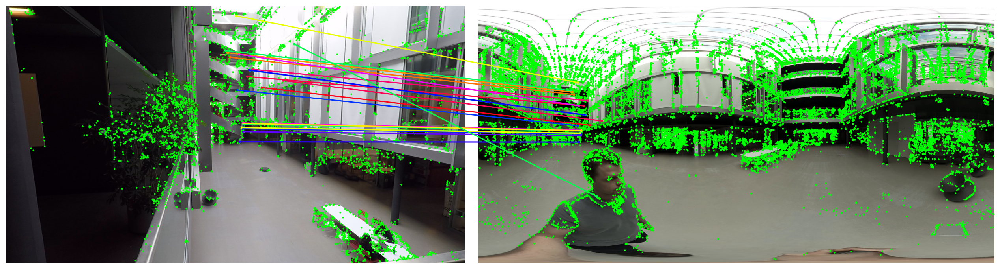

In [43]:
plot_images([img_o, img_o_2], dpi=150)
plot_keypoints([kpts_o, kpts_o_2])
plot_matches(kpts_o[matches["cam360_2148.jpg"][:,0]], kpts_o_2[matches["cam360_2148.jpg"][:,1]])

In [44]:
with gzip.open("./notebooks/opensfm/matches/cam360_2148.jpg_matches.pkl.gz", 'rb') as f:
    matches = pickle.load(f)

In [45]:
images = Path("../data/0-calibration/images")
outputs = Path("../data/0-calibration/outputs/")

# Load matches
sfm_pairs = outputs / "pairs-sfm.txt"
features = outputs / "features.h5"
matches = outputs / "matches.h5"


with open(sfm_pairs, "r") as fd:
    images_pairs = [tuple(l.strip().split()) for l in fd.readlines()]

# with h5py.File(features, "r") as fd:
#     print(fd.keys())
#     print(fd["cam1_view_forward"].keys())
#     print(fd["cam1_view_forward"]["100.jpg"].keys())
#     print(fd["cam1_view_forward"]["100.jpg"]["descriptors"][...].shape)
#     print(fd["cam1_view_forward"]["100.jpg"]["keypoint_scores"][...])
#     print(fd["cam1_view_forward"]["100.jpg"]["keypoints"][...])
    

#     print(fd.keys())
#     print(fd["cam360_view_forward"].keys())
#     print(fd["cam360_view_forward"]["1200.jpg"].keys())
#     print(fd["cam360_view_forward"]["1200.jpg"]["descriptors"][...].shape)
#     print(fd["cam360_view_forward"]["1200.jpg"]["keypoint_scores"][...])

# with h5py.File(matches, "r") as fd:
#     # print(fd.keys())
#     print(fd["cam1_view_forward-100.jpg"].keys())
#     print(fd["cam1_view_forward-100.jpg"]["cam360_view_forward-1924.jpg"].keys())
#     print(fd["cam1_view_forward-100.jpg"]["cam360_view_forward-1924.jpg"]["matches0"][...])
#     print(fd["cam1_view_forward-100.jpg"]["cam360_view_forward-1924.jpg"]["matching_scores0"][...])


In [46]:
images_pairs[100]

('cam1_view_forward/100.jpg', 'cam360_view_back/2596.jpg')

In [47]:
export_path = Path("")

FACES_NAME = ['forward','right','back','left','up','down']

def load_features(cam, img_name, feature_dset, root_image_folder, read_img=True):

    with h5py.File(features, "r") as fd:
        descriptors = fd[cam][img_name]["descriptors"][...]
        keypoint_scores = fd[cam][img_name]["keypoint_scores"][...]
        keypoints = fd[cam][img_name]["keypoints"][...]

    if read_img:
        img_path = root_image_folder / cam / img_name
        image = read_image(img_path)
        kpts_color = image[keypoints[:,1].astype(int), keypoints[:,0].astype(int)]
        w = image.shape[1]
        h = image.shape[0]
    else:
        kpts_color = np.array([])
        w = -1
        h = -1
        
    feature_dict = {
        "cam" : cam,
        "img_name" : img_name,
        "kpts" : keypoints,
        "desc" : descriptors,
        "scores" : keypoint_scores,
        "colors" : kpts_color,
        "img_w" : w,
        "img_h" : h
    }
    
    return feature_dict

def load360_features(cam, img_name, feature_dset, root_image_folder, eq_image_folder, face_w=960):

    # load feature for each cube_face

    cube_face_offsets = {}
    all_offsets = []
    nb_features = []

    all_kpts = []
    all_descriptors = []
    all_scores = []
    all_colors = []

    img_eq_path = eq_image_folder / img_name
    img_eq = read_image(img_eq_path)

    for side_name in FACES_NAME:
        side_cam = f"{cam.split('_')[0]}_view_{side_name}"
        # print(side_cam, img_name)
        face_feature_dict = load_features(side_cam, img_name, feature_dset, root_image_folder, read_img=False)
        
        # project to eq
        cube_face_shape = [face_w, face_w]
        kpts_eq, eq_color = kpts_to_eq(face_feature_dict["kpts"], cube_face_shape, side_name, img_eq)

        all_kpts.append(kpts_eq)
        all_descriptors.append(face_feature_dict["desc"].T)
        all_scores.append(face_feature_dict["scores"][..., np.newaxis])
        all_colors.append(eq_color)

        if len(cube_face_offsets) == 0:
            offset = 0
        else:
            offset = all_offsets[-1] + nb_features[-1]

        cube_face_offsets[side_name] = offset
        all_offsets.append(offset)
        nb_features.append(len(kpts_eq))

    # print(cube_face_offsets)
    # print([x.shape for x in all_kpts])
    # print([x.shape for x in all_descriptors])
    # print([x.shape for x in all_scores])
    # print([x.shape for x in all_colors])    
    
    # Combine face dicts
    feature_dict = {
        "cam" : cam.split('_')[0],
        "img_name" : img_name,
        "kpts" : np.vstack(all_kpts),
        "desc" : np.vstack(all_descriptors),
        "scores" : np.vstack(all_scores),
        "colors" : np.vstack(all_colors),
        "cube_face_offsets": cube_face_offsets,
        "img_w" : img_eq.shape[1],
        "img_h" : img_eq.shape[0]
    }

    return feature_dict

def load_matches(matches_dset, cam1, img_name1, cam2, img_name2):
    
    with h5py.File(matches_dset, "r") as fd:
        try:
            matches_img1_img2 = (fd[f"{cam1}-{img_name1}"][f"{cam2}-{img_name2}"]["matches0"][...])
            matches_img1_img2_score = (fd[f"{cam1}-{img_name1}"][f"{cam2}-{img_name2}"]["matching_scores0"][...])
        except:
            return [], []
        
        
        idx = np.where(matches_img1_img2 != -1)[0]
        matches_img1_img2 = np.stack([idx, matches_img1_img2[idx]], -1)
        matches_img1_img2_score = matches_img1_img2_score[idx]

    return matches_img1_img2, matches_img1_img2_score

def load_all_matches(cam1, img_name1, cam2, img_name2, all_img_features, matches_dset):

        if not cam1.startswith("cam360") and not cam2.startswith("cam360"):
            return load_matches(matches_dset, cam1, img_name1, cam2, img_name2)[0]
            
        elif not cam1.startswith("cam360") and cam2.startswith("cam360"):
            all_matches = []

            combined_name_2 = f"{cam2.split('_')[0]}_{img_name2}"
            cube_face_offsets = all_img_features[combined_name_2]["cube_face_offsets"]
            for side_name in FACES_NAME:
                side_cam = f"{cam2.split('_')[0]}_view_{side_name}"
                matches_img1_img2, matches_img1_img2_score = load_matches(matches_dset, cam1, img_name1, side_cam, img_name2)
                if len(matches_img1_img2) == 0:
                    continue
                #reindex_matches
                matches_img1_img2[:,1] += cube_face_offsets[side_name]
                all_matches.append(matches_img1_img2)

            return np.vstack(all_matches)
        elif cam1.startswith("cam360") and not cam2.startswith("cam360"):
            all_matches = []

            combined_name_1 = f"{cam1.split('_')[0]}_{img_name1}"
            cube_face_offsets = all_img_features[combined_name_1]["cube_face_offsets"]
            for side_name in FACES_NAME:
                side_cam = f"{cam1.split('_')[0]}_view_{side_name}"
                matches_img1_img2, matches_img1_img2_score = load_matches(matches_dset, side_cam, img_name1, cam2, img_name2)
                if len(matches_img1_img2) == 0:
                    continue
                #reindex_matches
                matches_img1_img2[:,0] += cube_face_offsets[side_name]
                all_matches.append(matches_img1_img2)

            return np.vstack(all_matches)

        elif cam1.startswith("cam360") and cam2.startswith("cam360"):
            all_matches = []

            combined_name_1 = f"{cam1.split('_')[0]}_{img_name1}"
            combined_name_2 = f"{cam2.split('_')[0]}_{img_name2}"
            
            cube_face_offsets_1 = all_img_features[combined_name_1]["cube_face_offsets"]
            cube_face_offsets_2 = all_img_features[combined_name_2]["cube_face_offsets"]
            
            for side_name_1 in FACES_NAME:
                side_cam_1 = f"{cam1.split('_')[0]}_view_{side_name_1}"
                for side_name2 in FACES_NAME:
                    side_cam_2 = f"{cam2.split('_')[0]}_view_{side_name2}"
                    matches_img1_img2, matches_img1_img2_score = load_matches(matches_dset, side_cam_1, img_name1, side_cam_2, img_name2)
                    if len(matches_img1_img2) == 0:
                        continue
                        
                    #reindex_matches
                    matches_img1_img2[:,0] += cube_face_offsets_1[side_name_1]
                    matches_img1_img2[:,1] += cube_face_offsets_2[side_name2]
                    all_matches.append(matches_img1_img2)

            return np.vstack(all_matches)
        else:
            print("UNknown combination of camera")
            raise notImplented
            

def export_features(img_dict, export_path):
    export_path.mkdir(parents=True, exist_ok=True)
    
    cam = img_dict["cam"]
    img_name = img_dict["img_name"]
    kpts = img_dict["kpts"]
    desc = img_dict["desc"]
    scores = img_dict["scores"]
    colors = img_dict["colors"]
    width = img_dict["img_w"]
    height = img_dict["img_h"]
    
    feature_path = export_path / f"{cam.split('_')[0]}_{img_name}.features.npz"
    
    if feature_path.exists():
        return

    points = np.zeros((kpts.shape[0], 4))
    
    points[:,2] = 1
    points[:,3] = -1
    points[:,:2] = normalized_image_coordinates(kpts, width, height)
    
    np.savez(feature_path, points=points, descriptors=desc, colors=colors, segmentations=np.array([]), instances=np.array([]), segmentation_labels=np.array([]), OPENSFM_FEATURES_VERSION=np.array([3]))

def export_matches(matches_dict, output_dir):
    output_dir.mkdir(parents=True, exist_ok=True)
    for k, v in matches_dict.items():
        with gzip.open(output_dir / f"{k}_matches.pkl.gz", 'wb') as f:
            pickle.dump(v, f)

    


In [48]:
def export_to_opensfm(opsfm_folder, images_pairs, feature_dset, matches_dset, root_image_folder, eq_image_folder):
    # Features are always sorted in that order: forward, right,back,left,up,down
    all_img_features = {}
    
    # Keep track of number of feature for each face of the cube
    cam360_cube_face_offsets = {}
    
    matches_dict = defaultdict(dict)

    for sample1, sample2 in tqdm(images_pairs):

        # print(f"------------{sample1}---------{sample2}-----------")
        cam1, img1_name = sample1.split("/")
        cam2, img2_name = sample2.split("/")
    
        
        combined_name_1 = f"{cam1.split('_')[0]}_{img1_name}"
        if combined_name_1 in all_img_features:
            img1_dict = all_img_features[combined_name_1]  #kpts_1, col_1, desc_1, scores_1, cube_face_offsets_1
        else:
            if cam1.startswith("cam360"):
                img1_dict = load360_features(cam1, img1_name, feature_dset, root_image_folder, eq_image_folder)
            else:
                img1_dict = load_features(cam1, img1_name, feature_dset, root_image_folder)
                all_img_features[combined_name_1] = img1_dict
                export_features(img1_dict, opsfm_folder / "features")
    
        
        combined_name_2 = f"{cam2.split('_')[0]}_{img2_name}"
        if combined_name_2 in all_img_features:
            img1_dict = all_img_features[combined_name_2]  #kpts_1, col_1, desc_1, scores_1, cube_face_offsets_1
        else:
            if cam2.startswith("cam360"):
                img2_dict = load360_features(cam2, img2_name, feature_dset, root_image_folder, eq_image_folder)
            else:
                img2_dict = load_features(cam2, img2_name, feature_dset, root_image_folder)
            
            all_img_features[combined_name_2] = img2_dict
            export_features(img2_dict, opsfm_folder / "features")

        if combined_name_1 in matches_dict and combined_name_2 in matches_dict[combined_name_1]:
            continue

        # print(combined_name_1, combined_name_2)
        # print(all_img_features.keys())
        
        img1_img2_matches = load_all_matches(cam1, img1_name, cam2, img2_name, all_img_features, matches_dset)
        matches_dict[combined_name_1][combined_name_2] = img1_img2_matches
    
    export_matches(matches_dict, opsfm_folder / "matches")
    

images = Path("../data/0-calibration/images")
outputs = Path("../data/0-calibration/outputs/")
opsfm_folder = Path("../data/0-calibration/opensfm/")

# Load matches
sfm_pairs = outputs / "pairs-sfm.txt"
features = outputs / "features.h5"
matches = outputs / "matches.h5"


with open(sfm_pairs, "r") as fd:
    images_pairs = [tuple(l.strip().split()) for l in fd.readlines()]

export_to_opensfm(opsfm_folder, images_pairs, features, matches, images, images/"cam360")

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18336/18336 [10:06<00:00, 30.23it/s]


NpzFile '../data/0-calibration/opensfm/features/cam2_100.jpg.features.npz' with keys: points, descriptors, colors, segmentations, instances...
(5000, 4)
(128, 5000)
(5000, 3)
(0,)
(0,)
points
descriptors
colors
segmentations
instances
segmentation_labels
OPENSFM_FEATURES_VERSION


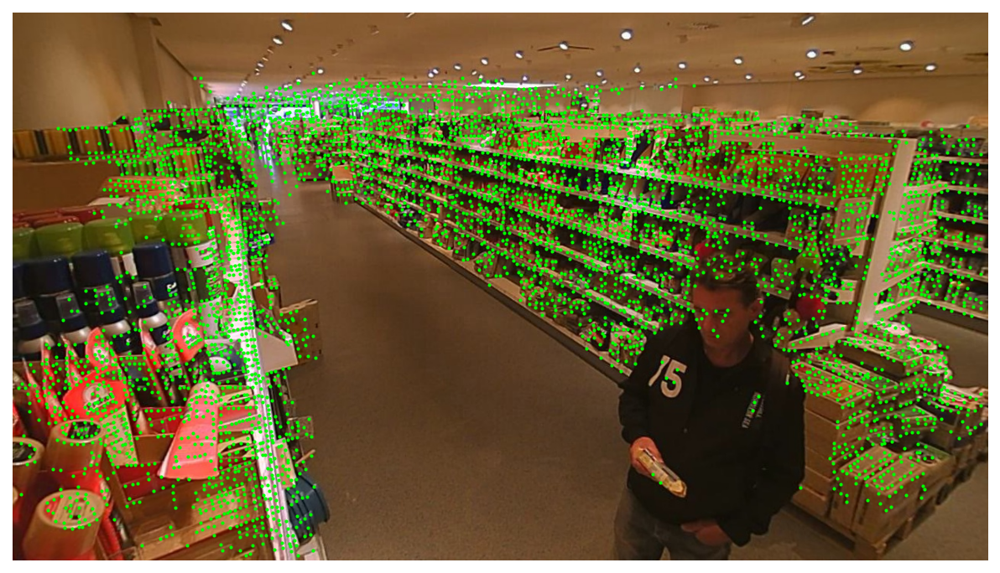

In [51]:
import numpy as np
# Load test ofpensfm formart
features = np.load("../data/0-calibration/opensfm/features/cam2_100.jpg.features.npz")

print(features)
print(features["points"].shape)
print(features["descriptors"].shape)
print(features["colors"].shape)
print(features["segmentations"].shape)
print(features["instances"].shape)

for k in features.keys():
    print(k)
    
img_o = cv2.imread("../data/0-calibration/images/cam2_view_forward/100.jpg")
img_o = cv2.cvtColor(img_o, cv2.COLOR_BGR2RGB)

kpts_o = features["points"][:, :2]
kpts_o = unnormalized_image_coordinates(kpts_o, img_o.shape[1], img_o.shape[0])

plot_images([img_o], dpi=150)
plot_keypoints([kpts_o])

In [88]:
img_o.shape

(720, 1280, 3)

In [56]:
import gzip
import pickle


with gzip.open("../data/0-calibration/opensfm/matches/cam2_100.jpg_matches.pkl.gz", 'rb') as f:
    matches = pickle.load(f)

print(matches.keys())
for k,v in matches.items():
    print(k, len(v))

print(matches["cam360_2234.jpg"].shape)
# print(matches["cam360_2648.jpg"])

dict_keys(['cam2_200.jpg', 'cam2_300.jpg', 'cam2_400.jpg', 'cam3_100.jpg', 'cam3_200.jpg', 'cam3_300.jpg', 'cam3_400.jpg', 'cam360_1458.jpg', 'cam360_1251.jpg', 'cam360_1510.jpg', 'cam360_1200.jpg', 'cam360_1355.jpg', 'cam360_1303.jpg', 'cam360_1613.jpg', 'cam360_1665.jpg', 'cam360_1562.jpg', 'cam360_1406.jpg', 'cam360_1872.jpg', 'cam360_2027.jpg', 'cam360_2079.jpg', 'cam360_1717.jpg', 'cam360_2131.jpg', 'cam360_1975.jpg', 'cam360_1924.jpg', 'cam360_1820.jpg', 'cam360_1768.jpg', 'cam360_2182.jpg', 'cam360_2700.jpg', 'cam360_2286.jpg', 'cam360_2441.jpg', 'cam360_2389.jpg', 'cam360_2493.jpg', 'cam360_2544.jpg', 'cam360_2648.jpg', 'cam360_2337.jpg', 'cam360_2234.jpg', 'cam360_2596.jpg'])
cam2_200.jpg 4294
cam2_300.jpg 4342
cam2_400.jpg 4337
cam3_100.jpg 4
cam3_200.jpg 2
cam3_300.jpg 3
cam3_400.jpg 5
cam360_1458.jpg 241
cam360_1251.jpg 322
cam360_1510.jpg 88
cam360_1200.jpg 384
cam360_1355.jpg 120
cam360_1303.jpg 110
cam360_1613.jpg 84
cam360_1665.jpg 158
cam360_1562.jpg 127
cam360_1406.jp

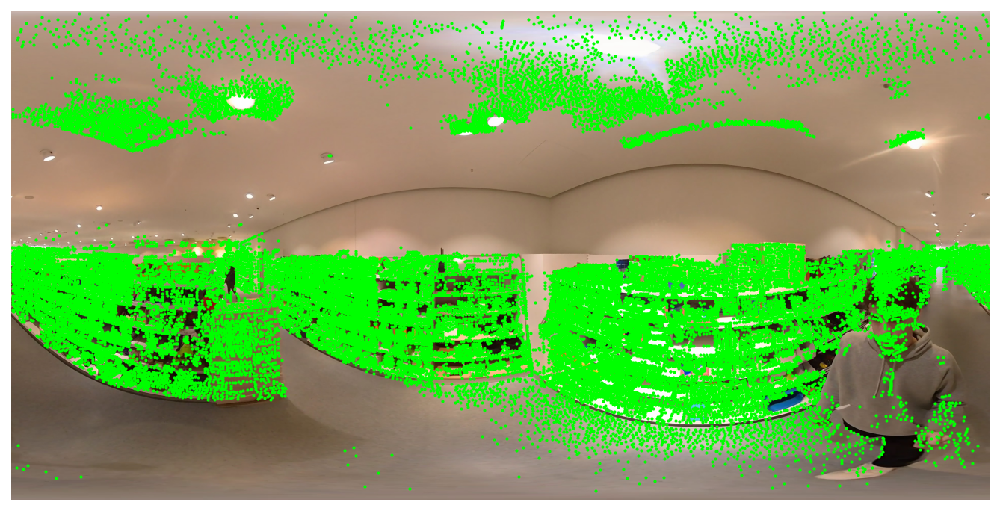

In [57]:
img_o_2 = cv2.imread("../data/0-calibration/images/cam360/2079.jpg")
img_o_2 = cv2.cvtColor(img_o_2, cv2.COLOR_BGR2RGB)

# plot_images([img_o_2], dpi=150)

features_2 = np.load("../data/0-calibration/opensfm/features/cam360_2079.jpg.features.npz")

kpts_o_2 = features_2["points"][:, :2]
kpts_o_2 = unnormalized_image_coordinates(kpts_o_2, img_o_2.shape[1], img_o_2.shape[0])

plot_images([img_o_2], dpi=150)
plot_keypoints([kpts_o_2])

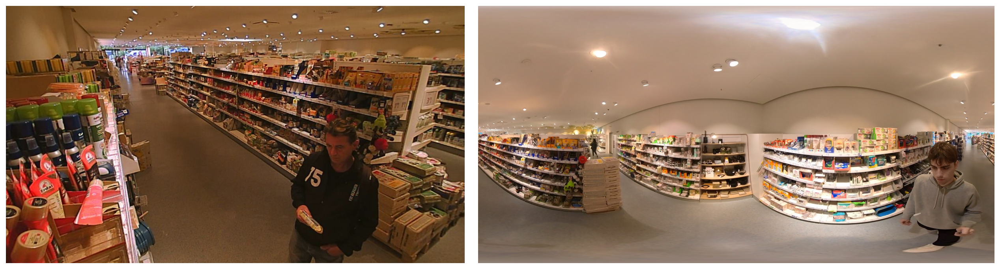

In [58]:
plot_images([img_o, img_o_2], dpi=150)

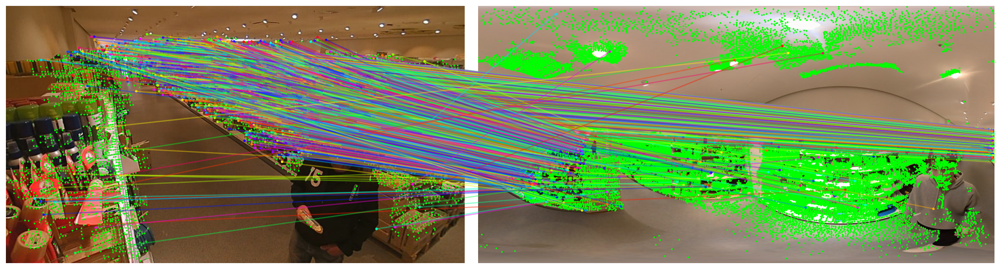

In [61]:
plot_images([img_o, img_o_2], dpi=150)
plot_keypoints([kpts_o, kpts_o_2])
plot_matches(kpts_o[matches["cam360_2079.jpg"][:,0]], kpts_o_2[matches["cam360_2079.jpg"][:,1]], a=0.4)

In [58]:
import pyexif
metadata = pyexif.ExifEditor("/cvlabscratch/cvlab/home/engilber/dev/pomelo_test_data/footage/cam360/Dm-Store.mp4")

In [60]:
print(metadata.__dict__)

{'save_backup': False, '_opt_expr': '-overwrite_original_in_place', 'photo': '/cvlabscratch/cvlab/home/engilber/dev/pomelo_test_data/footage/cam360/Dm-Store.mp4', '_rotations': {0: (0, 0), 1: (0, 0), 2: (0, 1), 3: (180, 0), 4: (180, 1), 5: (90, 1), 6: (90, 0), 7: (270, 1), 8: (270, 0)}, '_inverted_rotations': {(0, 0): 1, (0, 1): 2, (180, 0): 3, (180, 1): 4, (90, 1): 5, (90, 0): 6, (270, 1): 7, (270, 0): 8}, '_date_pattern': re.compile('\\d{4}:[01]\\d:[0-3]\\d$'), '_date_time_pattern': re.compile('\\d{4}:[01]\\d:[0-3]\\d [0-2]\\d:[0-5]\\d:[0-5]\\d$'), '_bad_tag_pat': re.compile("Warning: Tag '[^']+' does not exist")}


In [63]:
images = Path("../data/0-calibration/images")
outputs = Path("../data/0-calibration/outputs/")

# Load matches
sfm_pairs = outputs / "pairs-sfm.txt"
features = outputs / "features.h5"
matches = outputs / "matches.h5"

loftre = outputs / "matches-loftr_pairs-sfm.h5"

# with open(sfm_pairs, "r") as fd:
#     images_pairs = [tuple(l.strip().split()) for l in fd.readlines()]

# with h5py.File(features, "r") as fd:
#     print(fd.keys())
#     print(fd["cam1_view_forward"].keys())
#     print(fd["cam1_view_forward"]["100.jpg"].keys())
#     print(fd["cam1_view_forward"]["100.jpg"]["descriptors"][...].shape)
#     print(fd["cam1_view_forward"]["100.jpg"]["keypoint_scores"][...])
#     print(fd["cam1_view_forward"]["100.jpg"]["keypoints"][...])
    

#     print(fd.keys())
#     print(fd["cam360_view_forward"].keys())
#     print(fd["cam360_view_forward"]["1200.jpg"].keys())
#     print(fd["cam360_view_forward"]["1200.jpg"]["descriptors"][...].shape)
#     print(fd["cam360_view_forward"]["1200.jpg"]["keypoint_scores"][...])

# with h5py.File(matches, "r") as fd:
#     # print(fd.keys())
#     print(fd["cam1_view_forward-100.jpg"].keys())
#     print(fd["cam1_view_forward-100.jpg"]["cam360_view_forward-1924.jpg"].keys())
#     print(fd["cam1_view_forward-100.jpg"]["cam360_view_forward-1924.jpg"]["matches0"][...])
#     print(fd["cam1_view_forward-100.jpg"]["cam360_view_forward-1924.jpg"]["matching_scores0"][...])

In [81]:
with h5py.File(loftre, "r") as fd:
    # print(fd.keys())
    print(fd["cam1_view_forward-100.jpg"].keys())
    print(fd["cam1_view_forward-100.jpg"]["cam360_view_forward-1924.jpg"].keys())
    print(sum(fd["cam1_view_forward-100.jpg"]["cam360_view_forward-1924.jpg"]["matches0"][...] != -1))
    print(fd["cam1_view_forward-100.jpg"]["cam360_view_forward-1924.jpg"]["keypoints0"][...])
    print(fd["cam1_view_forward-100.jpg"]["cam360_view_forward-1924.jpg"]["keypoints1"][...])
    # print(fd["cam1_view_forward"]["100.jpg"]["keypoint_scores"][...])
    # print(fd["cam1_view_forward"]["100.jpg"]["keypoints"][...])

<KeysViewHDF5 ['cam1_view_forward-200.jpg', 'cam1_view_forward-300.jpg', 'cam1_view_forward-400.jpg', 'cam2_view_forward-100.jpg', 'cam2_view_forward-200.jpg', 'cam2_view_forward-300.jpg', 'cam2_view_forward-400.jpg', 'cam360_view_back-1200.jpg', 'cam360_view_back-1251.jpg', 'cam360_view_back-1303.jpg', 'cam360_view_back-1355.jpg', 'cam360_view_back-1406.jpg', 'cam360_view_back-1458.jpg', 'cam360_view_back-1510.jpg', 'cam360_view_back-1562.jpg', 'cam360_view_back-1613.jpg', 'cam360_view_back-1665.jpg', 'cam360_view_back-1717.jpg', 'cam360_view_back-1768.jpg', 'cam360_view_back-1820.jpg', 'cam360_view_back-1872.jpg', 'cam360_view_back-1924.jpg', 'cam360_view_back-1975.jpg', 'cam360_view_back-2027.jpg', 'cam360_view_back-2079.jpg', 'cam360_view_back-2131.jpg', 'cam360_view_back-2182.jpg', 'cam360_view_back-2234.jpg', 'cam360_view_back-2286.jpg', 'cam360_view_back-2337.jpg', 'cam360_view_back-2389.jpg', 'cam360_view_back-2441.jpg', 'cam360_view_back-2493.jpg', 'cam360_view_back-2544.jpg',

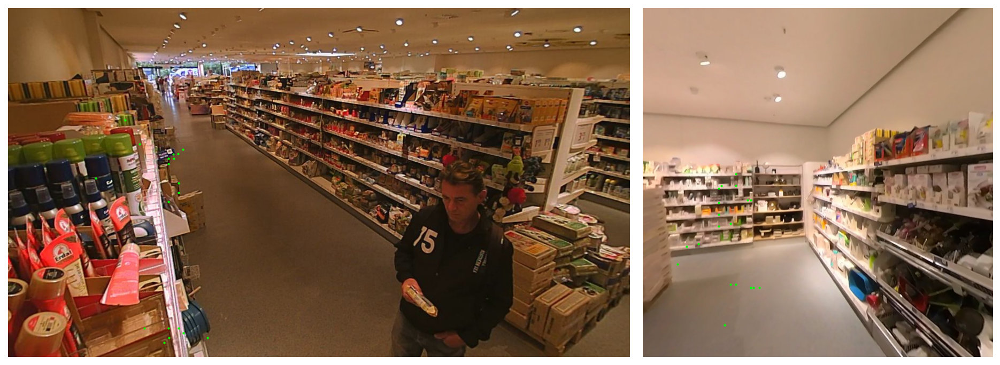

In [84]:

img_1 = cv2.imread("../data/0-calibration/images/cam2_view_forward/100.jpg")
img_1 = cv2.cvtColor(img_1, cv2.COLOR_BGR2RGB)

img_2 = cv2.imread("../data/0-calibration/images/cam360_view_forward/1924.jpg")
img_2 = cv2.cvtColor(img_2, cv2.COLOR_BGR2RGB)

with h5py.File(loftre, "r") as fd:
    kpts1 = fd["cam1_view_forward-100.jpg"]["cam360_view_forward-1924.jpg"]["keypoints0"][...]
    kpts2 = fd["cam1_view_forward-100.jpg"]["cam360_view_forward-1924.jpg"]["keypoints1"][...]

plot_images([img_1, img_2], dpi=150)
plot_keypoints([kpts1, kpts2])
# plot_matches(kpts[matches_img1_img2[:,0]], kpts_2[matches_img1_img2[:,1]])